In [1]:
from __future__ import print_function

import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from torchvision import models
from IPython.display import HTML
import time

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)

# Seed() method used to initialise a random number generator
# The random number generator requires a number to start with (seed value) to be able to generate a random number
# If you the same seed value you'll get the same set of random numbers
random.seed(manualSeed)

# Sets the seed for randomly generating values with pytorch
# TODO where is this used
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
### Dataroots for the different datasets
home_dir = "/home/a/Projects/dcgans-2d-pytorch/" # on machine
ext_dir = "/media/a/Seagate Basic/home/a/Projects/dggan-pytorch-2d-images/" # on external hard drive

## Celeba Dataset: 
# dataset_name = "celeba"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/celeba/"

## Scan The World main dataset:
# dataset_name = "scan-the-world-main-images"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/scan-the-world-main-images/"

## 2D Scan The World busts dataset: 
# dataset_name = "scan-the-world-busts-images"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/scan-the-world-busts-images/"

## Mixed god dataset:
# dataset_name = "mixed-gods"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/mixed-gods/"

# Sanitised mixed god dataset
# dataset_name = "sanitised-mixed-gods"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/sanitised-mixed-gods/"

# Sanitised mixed god dataset
# dataset_name = "sanitised-mixed-gods-scan-the-world"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/sanitised-mixed-gods-scan-the-world/"

# Unsanitised full dataset
# dataset_name = "unsanitised-full-dataset"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/all-scan-the-world-images/"

# # Facial recognition full dataset
# dataset_name = "facerecog-recog-full-dataset"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/facerecog-all-scan-the-world/"

# Tags classifier - busts
# dataset_name = "tags-classifier-fullbody"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/busts-tags-classifier/"
    
# Tags classifier - fullbody
# dataset_name = "tags-classifier-fullbody-label-smoothing-fake-0-0.3"
# dataroot = "/home/a/Projects/dggan-pytorch-2d-images/data/fullbody-tags-classifier/"

# Fully manually sanitised fullbody dataset
dataset_name = "fully-manually-sanitised-fullbody-dataset-label-smoothing"
dataroot = ext_dir + "data/fully-manually-sanitised-fullbody-dataset/"


workers = 2 
batch_size = 128
image_size = 64 
nc = 3
nz = 100
ngf = 64
ndf = 64
num_epochs = 100
lr = 0.0002
beta1 = 0.5
ngpu = 1

In [3]:
# Make output directory
results_dir = "results_" + dataset_name + "_epochs_" + str(num_epochs) + "_" + time.strftime("%Y%m%d-%H%M%S")
path = os.path.join(home_dir + "outputs", results_dir)
os.mkdir(path)

Size of the dataset:  32490


/home/a/anaconda3/envs/dcgans-2d-dev/lib/python3.9/site-packages/torch/cuda/__init__.py:52: UserWarning: CUDA initialization: Unexpected error from cudaGetDeviceCount(). Did you run some cuda functions before calling NumCudaDevices() that might have already set an error? Error 804: forward compatibility was attempted on non supported HW (Triggered internally at  /opt/conda/conda-bld/pytorch_1623448238472/work/c10/cuda/CUDAFunctions.cpp:115.)
  return torch._C._cuda_getDeviceCount() > 0


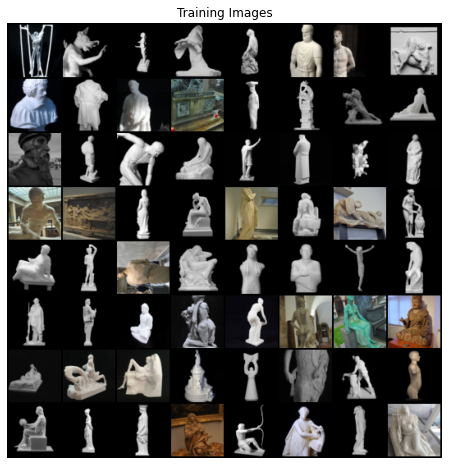

In [4]:
# Create dataset by standardising and normalizing the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Create the dataloader - python iterable over the dataset
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

dataset_size = len(dataloader.dataset)
print("Size of the dataset: ", dataset_size)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images before any training has begun
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [6]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [7]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            
            # state size. (ngf*8) x 4 x 4          
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            
            # state size. (ngf*2) x 16 x 16
            
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            
            
            
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
        
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            
            
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [11]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = np.random.uniform(0.7,1.2)
fake_label = 0.3


# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [12]:
import csv
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
D_fake_losses = []
D_real_losses = []
D_x_acc = []
D_G_z1_acc = []
D_G_z2_acc = []
iters = 0

wtr = csv.writer(open (os.path.join(path,'training_stats.csv'), 'w', newline=''))
wtr.writerow(["Current Epoch", "Total number of epochs", "Iteration", "Batch_size", "D_losses", "D_fake_losses", "D_real_losses", "G_losses", "D_accuracy", "D_G_z1_accurancy", "D_G_z2_accuracy"])
print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output - note this is loss on fake 
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_D_fake: %.4f\tLoss_D_real: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errD_fake.item(), errD_real.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            wtr.writerow([epoch, num_epochs, i, len(dataloader), errD.item(), errD_fake.item(), errD_real.item(), errG.item(), D_x, D_G_z1, D_G_z2])

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        D_fake_losses.append(errD_fake.item())
        D_real_losses.append(errD_real.item())
        D_x_acc.append(D_x)
        D_G_z1_acc.append(D_G_z1)
        D_G_z2_acc.append(D_G_z2)
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/100][0/254]	Loss_D: 1.5282	Loss_D_fake: 0.9192	Loss_D_real: 0.6089	Loss_G: 3.2969	D(x): 0.6212	D(G(z)): 0.5840 / 0.0352
[0/100][50/254]	Loss_D: 1.6082	Loss_D_fake: 1.2151	Loss_D_real: 0.3930	Loss_G: 9.7105	D(x): 0.8848	D(G(z)): 0.7877 / 0.0000
[0/100][100/254]	Loss_D: 0.9778	Loss_D_fake: 0.6435	Loss_D_real: 0.3343	Loss_G: 0.5771	D(x): 0.8679	D(G(z)): 0.2178 / 0.5858
[0/100][150/254]	Loss_D: 1.1146	Loss_D_fake: 0.6965	Loss_D_real: 0.4182	Loss_G: 1.5106	D(x): 0.7461	D(G(z)): 0.3852 / 0.2299
[0/100][200/254]	Loss_D: 1.3832	Loss_D_fake: 1.0375	Loss_D_real: 0.3457	Loss_G: 1.8942	D(x): 0.9218	D(G(z)): 0.7158 / 0.1574
[0/100][250/254]	Loss_D: 1.0634	Loss_D_fake: 0.6478	Loss_D_real: 0.4156	Loss_G: 0.6784	D(x): 0.7372	D(G(z)): 0.2858 / 0.5258
[1/100][0/254]	Loss_D: 1.1703	Loss_D_fake: 0.6877	Loss_D_real: 0.4826	Loss_G: 0.5612	D(x): 0.6780	D(G(z)): 0.1991 / 0.6078
[1/100][50/254]	Loss_D: 0.9989	Loss_D_fake: 0.6805	Loss_D_real: 0.3185	Loss_G: 1.3064	D(x): 0.8930	D(G(z

[11/100][0/254]	Loss_D: 1.2059	Loss_D_fake: 0.6472	Loss_D_real: 0.5586	Loss_G: 0.8114	D(x): 0.6076	D(G(z)): 0.3909 / 0.4441
[11/100][50/254]	Loss_D: 1.1235	Loss_D_fake: 0.7086	Loss_D_real: 0.4150	Loss_G: 1.0055	D(x): 0.7357	D(G(z)): 0.4662 / 0.3611
[11/100][100/254]	Loss_D: 1.2356	Loss_D_fake: 0.7393	Loss_D_real: 0.4963	Loss_G: 0.8663	D(x): 0.6530	D(G(z)): 0.5280 / 0.4185
[11/100][150/254]	Loss_D: 1.1349	Loss_D_fake: 0.7802	Loss_D_real: 0.3547	Loss_G: 1.3136	D(x): 0.8049	D(G(z)): 0.5614 / 0.2584
[11/100][200/254]	Loss_D: 1.2151	Loss_D_fake: 0.7561	Loss_D_real: 0.4590	Loss_G: 0.8258	D(x): 0.6890	D(G(z)): 0.5416 / 0.4400
[11/100][250/254]	Loss_D: 1.2004	Loss_D_fake: 0.6558	Loss_D_real: 0.5447	Loss_G: 0.7050	D(x): 0.6162	D(G(z)): 0.3906 / 0.5238
[12/100][0/254]	Loss_D: 1.1450	Loss_D_fake: 0.7621	Loss_D_real: 0.3829	Loss_G: 1.1374	D(x): 0.7645	D(G(z)): 0.5501 / 0.3072
[12/100][50/254]	Loss_D: 1.2165	Loss_D_fake: 0.6836	Loss_D_real: 0.5329	Loss_G: 0.9135	D(x): 0.6260	D(G(z)): 0.4524 / 0.405

[22/100][0/254]	Loss_D: 1.1650	Loss_D_fake: 0.6832	Loss_D_real: 0.4817	Loss_G: 0.7139	D(x): 0.6720	D(G(z)): 0.4567 / 0.4966
[22/100][50/254]	Loss_D: 1.1074	Loss_D_fake: 0.7165	Loss_D_real: 0.3909	Loss_G: 1.0920	D(x): 0.7563	D(G(z)): 0.4867 / 0.3285
[22/100][100/254]	Loss_D: 1.0858	Loss_D_fake: 0.7174	Loss_D_real: 0.3684	Loss_G: 1.0684	D(x): 0.7813	D(G(z)): 0.4963 / 0.3371
[22/100][150/254]	Loss_D: 1.1282	Loss_D_fake: 0.6830	Loss_D_real: 0.4452	Loss_G: 0.9088	D(x): 0.6988	D(G(z)): 0.4582 / 0.3974
[22/100][200/254]	Loss_D: 1.2762	Loss_D_fake: 0.6406	Loss_D_real: 0.6356	Loss_G: 0.5522	D(x): 0.5560	D(G(z)): 0.3004 / 0.6158
[22/100][250/254]	Loss_D: 1.1615	Loss_D_fake: 0.7190	Loss_D_real: 0.4425	Loss_G: 0.8534	D(x): 0.7083	D(G(z)): 0.4925 / 0.4281
[23/100][0/254]	Loss_D: 1.2705	Loss_D_fake: 0.6351	Loss_D_real: 0.6354	Loss_G: 0.5391	D(x): 0.5557	D(G(z)): 0.3206 / 0.6249
[23/100][50/254]	Loss_D: 1.0967	Loss_D_fake: 0.7323	Loss_D_real: 0.3644	Loss_G: 1.1545	D(x): 0.7878	D(G(z)): 0.5117 / 0.307

[33/100][0/254]	Loss_D: 1.0350	Loss_D_fake: 0.6799	Loss_D_real: 0.3551	Loss_G: 1.2849	D(x): 0.7982	D(G(z)): 0.4348 / 0.2669
[33/100][50/254]	Loss_D: 1.0659	Loss_D_fake: 0.6637	Loss_D_real: 0.4022	Loss_G: 0.8014	D(x): 0.7441	D(G(z)): 0.4015 / 0.4559
[33/100][100/254]	Loss_D: 1.0944	Loss_D_fake: 0.7015	Loss_D_real: 0.3929	Loss_G: 0.9950	D(x): 0.7568	D(G(z)): 0.4609 / 0.3714
[33/100][150/254]	Loss_D: 1.0289	Loss_D_fake: 0.6916	Loss_D_real: 0.3373	Loss_G: 1.1557	D(x): 0.8237	D(G(z)): 0.4572 / 0.3047
[33/100][200/254]	Loss_D: 1.1846	Loss_D_fake: 0.8643	Loss_D_real: 0.3204	Loss_G: 1.5096	D(x): 0.8575	D(G(z)): 0.6227 / 0.2095
[33/100][250/254]	Loss_D: 1.0235	Loss_D_fake: 0.6680	Loss_D_real: 0.3555	Loss_G: 1.1320	D(x): 0.8001	D(G(z)): 0.4010 / 0.3136
[34/100][0/254]	Loss_D: 1.1417	Loss_D_fake: 0.6493	Loss_D_real: 0.4924	Loss_G: 0.6280	D(x): 0.6535	D(G(z)): 0.3719 / 0.5569
[34/100][50/254]	Loss_D: 1.0783	Loss_D_fake: 0.6737	Loss_D_real: 0.4047	Loss_G: 0.9183	D(x): 0.7458	D(G(z)): 0.4209 / 0.398

[44/100][0/254]	Loss_D: 1.0291	Loss_D_fake: 0.6876	Loss_D_real: 0.3416	Loss_G: 1.2669	D(x): 0.8224	D(G(z)): 0.4507 / 0.2712
[44/100][50/254]	Loss_D: 1.0699	Loss_D_fake: 0.7175	Loss_D_real: 0.3524	Loss_G: 1.1168	D(x): 0.8066	D(G(z)): 0.4806 / 0.3206
[44/100][100/254]	Loss_D: 0.9994	Loss_D_fake: 0.6566	Loss_D_real: 0.3427	Loss_G: 1.2367	D(x): 0.8157	D(G(z)): 0.3940 / 0.2776
[44/100][150/254]	Loss_D: 1.0463	Loss_D_fake: 0.6922	Loss_D_real: 0.3541	Loss_G: 0.9823	D(x): 0.8059	D(G(z)): 0.4508 / 0.3696
[44/100][200/254]	Loss_D: 1.0109	Loss_D_fake: 0.6588	Loss_D_real: 0.3521	Loss_G: 1.0186	D(x): 0.8054	D(G(z)): 0.4027 / 0.3540
[44/100][250/254]	Loss_D: 1.0906	Loss_D_fake: 0.7315	Loss_D_real: 0.3591	Loss_G: 1.2189	D(x): 0.7969	D(G(z)): 0.5089 / 0.2834
[45/100][0/254]	Loss_D: 1.0485	Loss_D_fake: 0.7354	Loss_D_real: 0.3131	Loss_G: 1.4861	D(x): 0.8814	D(G(z)): 0.5096 / 0.2111
[45/100][50/254]	Loss_D: 1.7735	Loss_D_fake: 1.4586	Loss_D_real: 0.3149	Loss_G: 0.9162	D(x): 0.9190	D(G(z)): 0.8399 / 0.417

[55/100][0/254]	Loss_D: 1.5015	Loss_D_fake: 1.1935	Loss_D_real: 0.3080	Loss_G: 1.7726	D(x): 0.9108	D(G(z)): 0.7764 / 0.1552
[55/100][50/254]	Loss_D: 1.0683	Loss_D_fake: 0.6514	Loss_D_real: 0.4169	Loss_G: 0.7712	D(x): 0.7285	D(G(z)): 0.2378 / 0.4697
[55/100][100/254]	Loss_D: 1.0741	Loss_D_fake: 0.6571	Loss_D_real: 0.4169	Loss_G: 0.8008	D(x): 0.7282	D(G(z)): 0.2519 / 0.4575
[55/100][150/254]	Loss_D: 1.0338	Loss_D_fake: 0.6392	Loss_D_real: 0.3946	Loss_G: 0.8246	D(x): 0.7533	D(G(z)): 0.2977 / 0.4420
[55/100][200/254]	Loss_D: 1.1307	Loss_D_fake: 0.6607	Loss_D_real: 0.4700	Loss_G: 0.5193	D(x): 0.6801	D(G(z)): 0.2085 / 0.6418
[55/100][250/254]	Loss_D: 1.0487	Loss_D_fake: 0.6427	Loss_D_real: 0.4060	Loss_G: 0.8379	D(x): 0.7411	D(G(z)): 0.3635 / 0.4325
[56/100][0/254]	Loss_D: 1.0681	Loss_D_fake: 0.6351	Loss_D_real: 0.4330	Loss_G: 0.7355	D(x): 0.7133	D(G(z)): 0.2936 / 0.4893
[56/100][50/254]	Loss_D: 1.0420	Loss_D_fake: 0.6559	Loss_D_real: 0.3861	Loss_G: 0.9251	D(x): 0.7617	D(G(z)): 0.3844 / 0.391

[66/100][0/254]	Loss_D: 1.1144	Loss_D_fake: 0.6738	Loss_D_real: 0.4407	Loss_G: 0.9466	D(x): 0.7042	D(G(z)): 0.4255 / 0.3851
[66/100][50/254]	Loss_D: 1.0707	Loss_D_fake: 0.6451	Loss_D_real: 0.4256	Loss_G: 0.8012	D(x): 0.7217	D(G(z)): 0.3165 / 0.4518
[66/100][100/254]	Loss_D: 1.0019	Loss_D_fake: 0.6663	Loss_D_real: 0.3357	Loss_G: 1.1781	D(x): 0.8383	D(G(z)): 0.4101 / 0.2993
[66/100][150/254]	Loss_D: 0.9809	Loss_D_fake: 0.6399	Loss_D_real: 0.3409	Loss_G: 0.8848	D(x): 0.8227	D(G(z)): 0.3192 / 0.4129
[66/100][200/254]	Loss_D: 1.0136	Loss_D_fake: 0.6478	Loss_D_real: 0.3658	Loss_G: 0.7319	D(x): 0.7855	D(G(z)): 0.2469 / 0.4883
[66/100][250/254]	Loss_D: 0.9987	Loss_D_fake: 0.6521	Loss_D_real: 0.3466	Loss_G: 1.2588	D(x): 0.8120	D(G(z)): 0.3748 / 0.2703
[67/100][0/254]	Loss_D: 1.0998	Loss_D_fake: 0.6403	Loss_D_real: 0.4595	Loss_G: 0.8138	D(x): 0.6846	D(G(z)): 0.2832 / 0.4543
[67/100][50/254]	Loss_D: 1.1231	Loss_D_fake: 0.8149	Loss_D_real: 0.3082	Loss_G: 1.5201	D(x): 0.8930	D(G(z)): 0.5738 / 0.204

[77/100][0/254]	Loss_D: 0.9592	Loss_D_fake: 0.6412	Loss_D_real: 0.3180	Loss_G: 1.0147	D(x): 0.8569	D(G(z)): 0.2964 / 0.3524
[77/100][50/254]	Loss_D: 1.0238	Loss_D_fake: 0.7188	Loss_D_real: 0.3050	Loss_G: 1.5637	D(x): 0.9358	D(G(z)): 0.4969 / 0.1914
[77/100][100/254]	Loss_D: 1.0304	Loss_D_fake: 0.6411	Loss_D_real: 0.3892	Loss_G: 0.9421	D(x): 0.7585	D(G(z)): 0.3363 / 0.3839
[77/100][150/254]	Loss_D: 1.1982	Loss_D_fake: 0.6874	Loss_D_real: 0.5108	Loss_G: 0.4490	D(x): 0.6406	D(G(z)): 0.1749 / 0.6920
[77/100][200/254]	Loss_D: 0.9633	Loss_D_fake: 0.6371	Loss_D_real: 0.3262	Loss_G: 1.1613	D(x): 0.8423	D(G(z)): 0.3220 / 0.2967
[77/100][250/254]	Loss_D: 0.9613	Loss_D_fake: 0.6460	Loss_D_real: 0.3153	Loss_G: 1.2440	D(x): 0.8620	D(G(z)): 0.3584 / 0.2714
[78/100][0/254]	Loss_D: 0.9440	Loss_D_fake: 0.6355	Loss_D_real: 0.3084	Loss_G: 1.2484	D(x): 0.8807	D(G(z)): 0.3105 / 0.2696
[78/100][50/254]	Loss_D: 0.9522	Loss_D_fake: 0.6462	Loss_D_real: 0.3060	Loss_G: 1.3814	D(x): 0.8943	D(G(z)): 0.3578 / 0.232

[88/100][0/254]	Loss_D: 1.3800	Loss_D_fake: 0.9181	Loss_D_real: 0.4619	Loss_G: 0.7584	D(x): 0.6862	D(G(z)): 0.6603 / 0.4746
[88/100][50/254]	Loss_D: 1.1795	Loss_D_fake: 0.8049	Loss_D_real: 0.3745	Loss_G: 1.1009	D(x): 0.7809	D(G(z)): 0.5765 / 0.3289
[88/100][100/254]	Loss_D: 1.0207	Loss_D_fake: 0.6584	Loss_D_real: 0.3624	Loss_G: 1.2385	D(x): 0.7928	D(G(z)): 0.4085 / 0.2746
[88/100][150/254]	Loss_D: 1.1014	Loss_D_fake: 0.7911	Loss_D_real: 0.3103	Loss_G: 1.5401	D(x): 0.9151	D(G(z)): 0.5591 / 0.2002
[88/100][200/254]	Loss_D: 1.1855	Loss_D_fake: 0.8753	Loss_D_real: 0.3102	Loss_G: 1.4807	D(x): 0.8982	D(G(z)): 0.6296 / 0.2157
[88/100][250/254]	Loss_D: 0.9921	Loss_D_fake: 0.6601	Loss_D_real: 0.3320	Loss_G: 1.1029	D(x): 0.8323	D(G(z)): 0.3958 / 0.3199
[89/100][0/254]	Loss_D: 0.9689	Loss_D_fake: 0.6559	Loss_D_real: 0.3130	Loss_G: 1.3069	D(x): 0.8735	D(G(z)): 0.3836 / 0.2531
[89/100][50/254]	Loss_D: 0.9783	Loss_D_fake: 0.6506	Loss_D_real: 0.3278	Loss_G: 1.1542	D(x): 0.8398	D(G(z)): 0.3685 / 0.300

[99/100][0/254]	Loss_D: 0.9479	Loss_D_fake: 0.6389	Loss_D_real: 0.3090	Loss_G: 1.1318	D(x): 0.8731	D(G(z)): 0.3037 / 0.3057
[99/100][50/254]	Loss_D: 0.9581	Loss_D_fake: 0.6503	Loss_D_real: 0.3078	Loss_G: 1.4555	D(x): 0.8861	D(G(z)): 0.3760 / 0.2137
[99/100][100/254]	Loss_D: 1.0981	Loss_D_fake: 0.7901	Loss_D_real: 0.3080	Loss_G: 1.8566	D(x): 0.9185	D(G(z)): 0.5702 / 0.1421
[99/100][150/254]	Loss_D: 0.9401	Loss_D_fake: 0.6356	Loss_D_real: 0.3045	Loss_G: 1.2613	D(x): 0.8887	D(G(z)): 0.3399 / 0.2643
[99/100][200/254]	Loss_D: 1.0432	Loss_D_fake: 0.6608	Loss_D_real: 0.3823	Loss_G: 0.7499	D(x): 0.7624	D(G(z)): 0.2196 / 0.4846
[99/100][250/254]	Loss_D: 0.9741	Loss_D_fake: 0.6329	Loss_D_real: 0.3411	Loss_G: 0.7475	D(x): 0.8140	D(G(z)): 0.3002 / 0.4767


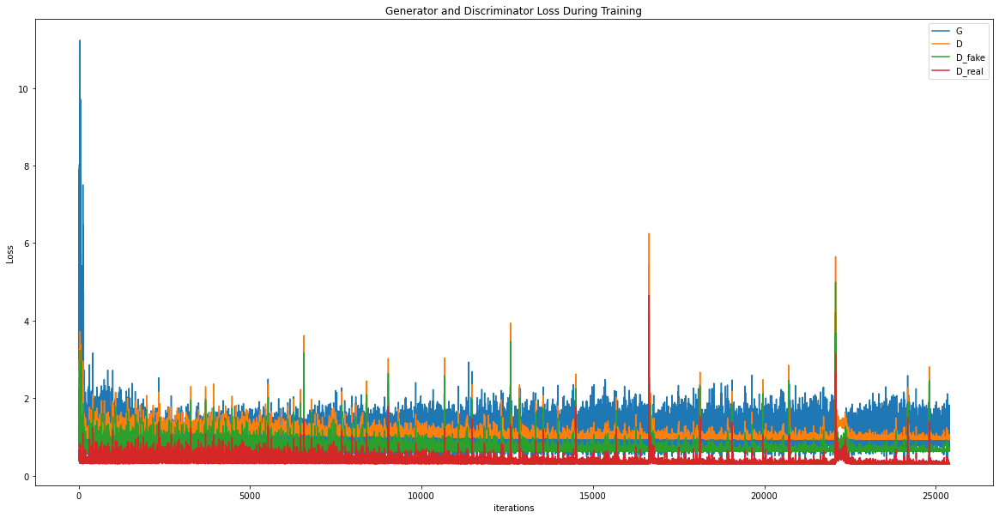

In [13]:
plt.figure(figsize=(20,10))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.plot(D_fake_losses,label="D_fake")
plt.plot(D_real_losses,label="D_real")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.savefig(os.path.join(path,"generator_discriminator_losses.png"))

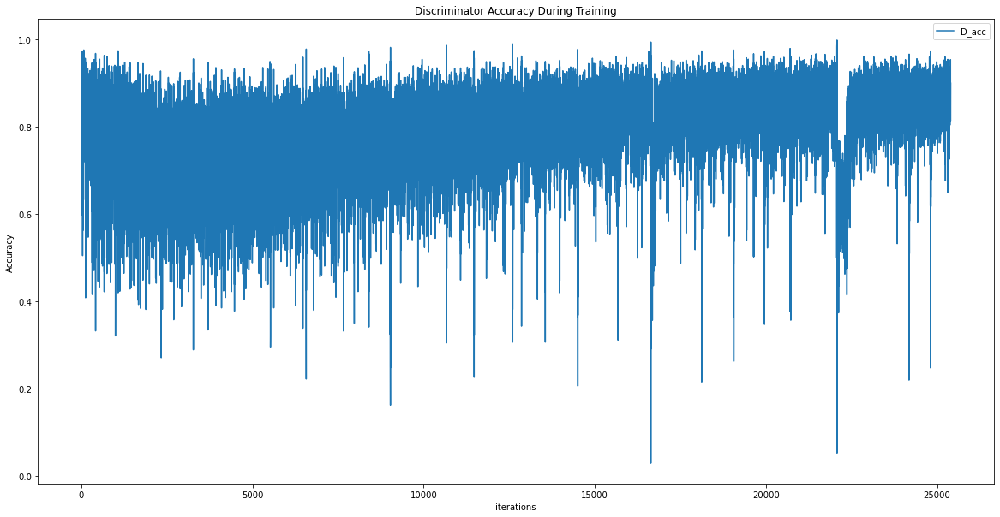

In [14]:
plt.figure(figsize=(20,10))
plt.title("Discriminator Accuracy During Training")
plt.plot(D_x_acc,label="D_acc")
plt.xlabel("iterations")
plt.ylabel("Accuracy")
plt.legend()
plt.savefig(os.path.join(path,"discriminator_accuracy.png"))

In [15]:
from scipy import stats


d_losses_mode = stats.mode(D_losses)
d_fake_losses_mode = stats.mode(D_fake_losses)
d_real_losses_mode = stats.mode(D_real_losses)
g_losses_mode = stats.mode(G_losses)

f = open(os.path.join(path,"overall_stats.txt"), "a")
f.write("Dataset: \t" + dataset_name +"\n")
f.write("Dataset size: \t" + str(dataset_size) +"\n")
f.write("D_losses mean: \t" + str(np.mean(D_losses)) +"\n")
f.write("D_losses mode: \t" + str(d_losses_mode.mode[0]) +"\n")
f.write("D_fake_losses mean: \t" + str(np.mean(D_fake_losses)) +"\n")
f.write("D_fake_losses mode: \t" + str(d_fake_losses_mode.mode[0]) +"\n")
f.write("D_real_losses mean: \t" + str(np.mean(D_real_losses)) +"\n")
f.write("D_real_losses mode: \t" + str(d_real_losses_mode.mode[0]) +"\n")
f.write("G_losses mean: \t" + str(np.mean(G_losses)) +"\n")
f.write("G_losses mode: \t" + str(g_losses_mode.mode[0]) +"\n")
f.write("Discriminator accuracy mean \t" + str(np.mean(D_x_acc)))

f.close()

ModuleNotFoundError: No module named 'scipy'

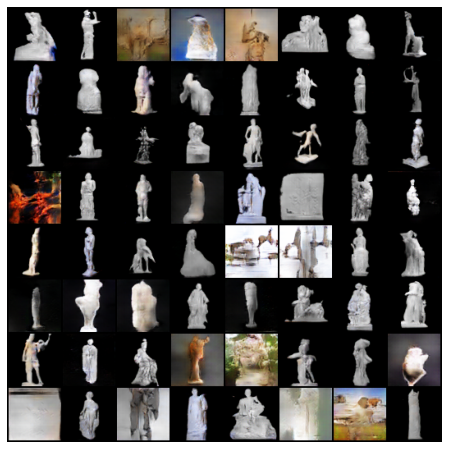

In [16]:
# Animation of generations over time

#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

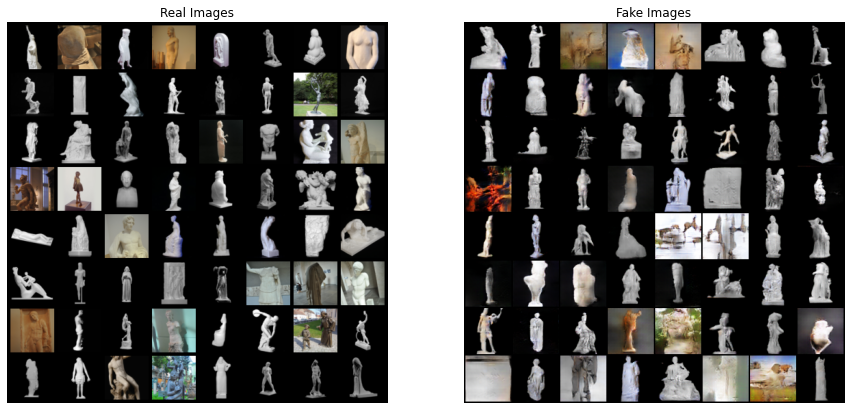

In [17]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.savefig(os.path.join(path,"real_vs_fake_images.png"))

In [18]:
from torchvision.utils import save_image

gen_img_dir = os.path.join(path, "generated_images")
if not os.path.exists(gen_img_dir):
    os.mkdir(gen_img_dir)
im_batch_size = 64
n_images=100
for i_batch in range(0, n_images, im_batch_size):
    gen_images = netG(fixed_noise)
    images = gen_images.to("cpu").clone().detach()
    images = images.numpy().transpose(0, 2, 3, 1)
    for i_image in range(gen_images.size(0)):
        save_image(gen_images[i_image, :, :, :], os.path.join(gen_img_dir, f'image_{i_batch+i_image:05d}.png'))

In [19]:
from zipfile import ZipFile
from os.path import basename


zip_file = home_dir + "outputs/" + results_dir + ".zip"
with ZipFile(zip_file, 'w') as zipObj:
   # Iterate over all the files in directory
   for folderName, subfolders, filenames in os.walk(path):
       for filename in filenames:
           #create complete filepath of file in directory
           filePath = os.path.join(folderName, filename)
           # Add file to zip
           zipObj.write(filePath, basename(filePath))